# **Maestría en Inteligencia Artificial Aplicada**

## **Operaciones de aprendizaje automatico**

### Tecnológico de Monterrey

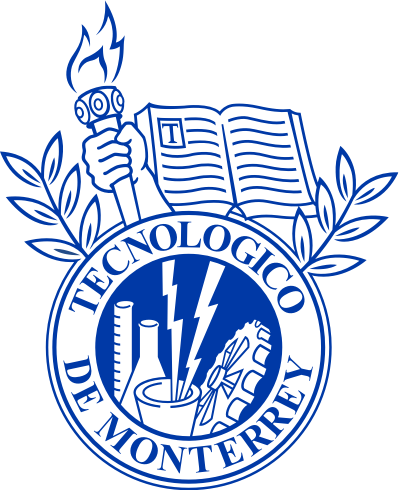

### Equipo 17

 Iván Nava Cardeño 

 Flavio César Palacios Salas

 Luis Enrique Gonzáles Gonzáles

 Fanny Betsabé Fuentes Reyes

 Emanuel Flores Martinez 



## Simulación de Data Drift con Detección de Pérdida de Performance

Para modelar el datadrif necesario para simular la detección de pérdida de performance, se utilizará la librería `alibi-detect`, la cual cuenta con varios métodos para modelar diferentes tipos de datadrift. En este caso, se utilizará el método `KSDrift` para detectar cambios en la distribución de los datos.

In [61]:
## Import libraries and modules
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import seaborn as sns
import os
from evidently import Report
from evidently.presets import DataDriftPreset, DataSummaryPreset 
import logging
from dotenv import load_dotenv
import mlflow

import sys
sys.path.append("../")


from src.data_drift import DataDriftGenerator



In [63]:
def plot_kde_hist(df, hue = None, n_cols=4):
    """"
    Dibuja gráficos KDE para variables numéricas en un DataFrame, con opción de agrupar por una variable categórica.
    """
    # Solo columnas numéricas
    df_numeric = df.select_dtypes(include='number')
    num_plots = len(df_numeric.columns)

    # Calcular filas necesarias
    n_rows = math.ceil(num_plots / n_cols)

    # Crear subplots (ajusta el número de filas/columnas según lo que necesites)
    fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(14, 8))
    axes = axes.flatten() 

    fig.suptitle('Comparación de la Distribución KDE de las variables númericas', fontsize=20)
    # Generar gráfico KDE por cada columna
    for ax, col in zip(axes, df_numeric.columns):
        sns.kdeplot(data=df, x = col,hue=hue, ax=ax, fill=True )
        ax.set_title(f'{col}')
        ax.set_xlabel("Valor")
        ax.set_ylabel("Densidad")
        ax.grid(True)

     # Ocultar subplots vacíos si los hay
    for j in range(num_plots, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()


def boxplots(df, n_cols=4, figsize_per_plot=(4, 4), y = None, hue = None):
    # Seleccionar columnas numéricas
    df_numeric = df.select_dtypes(include='number')
    num_plots = len(df_numeric.columns)

    # Calcular filas necesarias
    n_rows = math.ceil(num_plots / n_cols)

    # Crear figura y subplots
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * figsize_per_plot[0], n_rows * figsize_per_plot[1]))
    axes = axes.flatten()  # Para indexar fácilmente, aunque sea 1D

    for i, col in enumerate(df_numeric.columns):
        ax = axes[i]
        sns.boxplot(data=df, x = col, ax=ax, orient= 'h', y = y, hue = hue)
        ax.set_title(f'{col}')
        ax.grid(True)

    # Ocultar subplots vacíos si los hay
    for j in range(num_plots, len(axes)):
        axes[j].set_visible(False)

    fig.suptitle('Box-Plot de las variables númericas', fontsize=20)

    plt.tight_layout()
    plt.show()

In [64]:
# Load the dataset

data_path = os.path.abspath("../data/processed/steel_energy_modified_clean.csv")
df = pd.read_csv(data_path, parse_dates=["date"])


# Initialize drift generator
drift_gen = DataDriftGenerator(original_data= df, random_state=42)

# 1. Gradual drift
gradual_drift = drift_gen.generate_gradual_drift(n_samples=5000, drift_intensity=0.3)

# 2. Sudden drift
sudden_drift = drift_gen.generate_sudden_drift(n_samples=5000, changepoint=0.5, drift_intensity=0.5)

# 3. Seasonal drift
seasonal_drift = drift_gen.generate_seasonal_drift(n_samples=5000, amplitude=0.3)

# 4. Multivariate drift
multivariate_drift = drift_gen.generate_multivariate_drift(n_samples=5000, drift_intensity=0.4)

# 5. Categorical drift
categorical_drift = drift_gen.generate_categorical_drift(n_samples=5000)



In [65]:
# Copy of the original dataframes for comparison visualization
df2 = df.copy()
gradual_drift2 = gradual_drift.copy()
sudden_drift2 = sudden_drift.copy()
seasonal_drift2 = seasonal_drift.copy()
multivariate_drift2 = multivariate_drift.copy()
categorical_drift2 = categorical_drift.copy()


# Combine all datasets and add a column to identify the source dataset
df2['Dataset'] = "Original"
gradual_drift2['Dataset'] = "Gradual Drift"
sudden_drift2['Dataset'] = "Sudden Drift"
seasonal_drift2['Dataset'] = "Seasonal Drift"  
multivariate_drift2['Dataset'] = "Multivariate Drift"
categorical_drift2['Dataset'] = "Categorical Drift"


combined_df = pd.concat([df2, gradual_drift2, sudden_drift2, seasonal_drift2, multivariate_drift2, categorical_drift2], ignore_index=True)

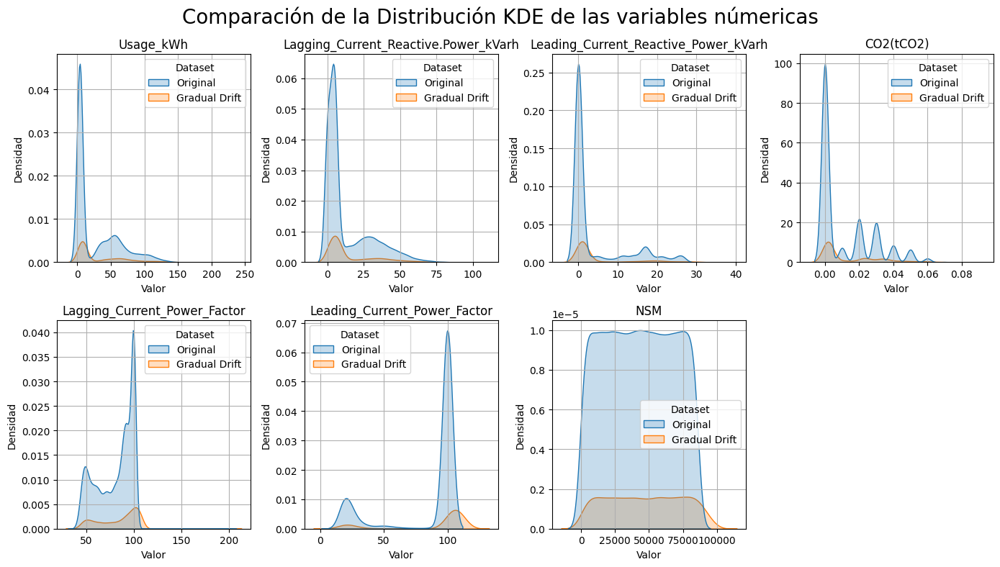

In [66]:
# Comparación de distribuciones entre los dos datasets sin outliers
plot_kde_hist(combined_df[(combined_df['Dataset'] == 'Original') | (combined_df['Dataset'] == 'Gradual Drift')], hue = 'Dataset', n_cols=4)

In [67]:


report = Report(metrics=[DataDriftPreset()])
my_eval_gradual = report.run(reference_data=df, current_data=gradual_drift)
my_eval_suden = report.run(reference_data=df, current_data=sudden_drift)
my_eval_seasonal = report.run(reference_data=df, current_data=seasonal_drift)
my_eval_multivariate = report.run(reference_data=df, current_data=multivariate_drift)
my_eval_categorical = report.run(reference_data=df, current_data=categorical_drift)



In [68]:
my_eval_gradual

In [17]:
my_eval_suden

In [15]:
my_eval_seasonal

In [16]:
my_eval_multivariate

In [18]:
my_eval_categorical

In [69]:
# Configure logging
logging.basicConfig(
    level=logging.INFO,
    format='%(asctime)s - %(name)s - %(levelname)s - %(message)s'
)
logger = logging.getLogger(__name__)

# Global variables for model
model = None
model_metadata = {}


def load_model_from_registry(
    model_name: str = "steel-energy-cubist",
    stage: str = "Production"
) -> tuple:
    """
    Load model from MLflow Model Registry.

    Args:
        model_name: Name of the model in MLflow registry
        stage: Model stage (Production, Staging, None) or version number

    Returns:
        Tuple of (model, metadata_dict)

    Raises:
        Exception: If model cannot be loaded
    """
    logger.info(f"Loading model '{model_name}' from MLflow registry (stage: {stage})...")

    # Load environment variables
    load_dotenv()

    # Set MLflow tracking URI
    tracking_uri = os.getenv("MLFLOW_TRACKING_URI")
    if not tracking_uri:
        raise ValueError("MLFLOW_TRACKING_URI not found in environment variables")

    mlflow.set_tracking_uri(tracking_uri)
    logger.info(f"MLflow tracking URI: {tracking_uri}")

    # Construct model URI
    model_uri = f"models:/{model_name}/{stage}"

 
    # Load the model
    loaded_model = mlflow.pyfunc.load_model(model_uri)
    return loaded_model

In [70]:
model_cubist = load_model_from_registry()

INFO:__main__:Loading model 'steel-energy-cubist' from MLflow registry (stage: Production)...
INFO:__main__:MLflow tracking URI: https://dagshub.com/luisegg/mlops-team17-project.mlflow


2025/11/15 22:55:19 WARNING mlflow.utils.requirements_utils: Detected one or more mismatches between the model's dependencies and the current Python environment:
 - numpy (current: 1.26.4, required: numpy==2.3.3)
To fix the mismatches, call `mlflow.pyfunc.get_model_dependencies(model_uri)` to fetch the model's environment and install dependencies using the resulting environment file.
2025/11/15 22:55:19 WARNING mlflow.pyfunc: The version of Python that the model was saved in, `Python 3.13.3`, differs from the version of Python that is currently running, `Python 3.11.9`, and may be incompatible


In [80]:
TARGET = "Usage_kWh"

splitter = lambda dataf, target_column: (dataf[target_column].copy(), dataf.drop(columns=[target_column]).copy())

In [85]:
Y_s, X_s  = splitter(seasonal_drift, target_column= TARGET)
X_s['NSM'] = X_s['NSM'].astype('int64')

In [89]:
X_s

,date,Lagging_Current_Reactive.Power_kVarh,Leading_Current_Reactive_Power_kVarh,CO2(tCO2),Lagging_Current_Power_Factor,Leading_Current_Power_Factor,NSM,WeekStatus,Day_of_week,Load_Type
0,2018-10-29 00:30:00,4.955152,0.000000,0.001064,48.229273,101.412571,3366,Weekday,Monday,Light_Load
1,2018-07-21 16:45:00,15.106563,0.164507,0.020229,95.733326,99.631731,60872,Weekend,Saturday,Maximum_Load
2,2018-01-11 14:15:00,35.177990,0.012331,0.050580,96.241252,100.508314,48706,Weekday,Thursday,Medium_Load
3,2018-03-10 15:45:00,1.514016,5.505625,0.010424,101.846401,100.187845,56066,Weekend,Saturday,Maximum_Load
4,2018-10-02 10:45:00,44.316556,0.592539,0.030481,82.911735,102.595763,40658,Weekday,Tuesday,Maximum_Load
...,...,...,...,...,...,...,...,...,...,...
4995,2018-01-25 09:30:00,31.421907,0.000000,0.032729,94.841881,101.872058,35818,Weekday,Thursday,Medium_Load
4996,2018-05-27 18:00:00,1.289838,16.922259,0.002126,101.618354,20.726786,65833,Weekend,Sunday,Light_Load
4997,2018-01-23 02:45:00,29.299409,0.856038,0.021349,83.323612,106.255231,12921,Weekday,Tuesday,Light_Load
4998,2018-03-06 16:00:00,31.026059,0.793439,0.032082,95.173103,105.116255,61200,Weekday,Tuesday,Maximum_Load


In [87]:
model_cubist.metadata.signature

inputs: 
  ['date': datetime (required), 'Lagging_Current_Reactive.Power_kVarh': double (required), 'Leading_Current_Reactive_Power_kVarh': double (required), 'CO2(tCO2)': double (required), 'Lagging_Current_Power_Factor': double (required), 'Leading_Current_Power_Factor': double (required), 'NSM': long (required), 'WeekStatus': string (required), 'Day_of_week': string (required), 'Load_Type': string (required)]
outputs: 
  [Tensor('float64', (-1,))]
params: 
  None

In [86]:
model_cubist.predict(X_s)

c:\Users\Flavs\Documents\Tec Monterrey\Mlops\.venv\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but Cubist was fitted with feature names



array([  4.67873621,  48.92359924, 122.45097351, ...,  44.14319992,
        94.55150604,  32.61907578])